# **HCAIM – Human Centric Deep Learning 2022/23**
# **CA3 (50% Weighting) – Group Work**

**Members:**
- Cloë Van Geest - X00204826
- Debby Yong - X00205680
- Zaur Gouliev - X00205702


**Lecturer:**
- Dr Keith Quille

**Project Description:**
- This is a group work where students will develop a deep learning model for a specific context, with an emphasis on producing evidence of transparency, Explainability while using suitable XAI techniques.
- The data that will be used in this group work is from Kaggle which is about **Airline Customer Satisfaction**.

---

# **Sections**

1. **Introduction, Background, and Rationale on the Dataset**

2. **Opening the dataset, Data exploration for potential bias, Data pre-processing**

3. **Model Development**
 - Black Box
 - Glass Box
   
4. **Model Performance Evaluation**
  
5. **XAI (Explainable AI) for the Model**
 - Lime
 - Shap
   
6. **Discussion on Model Performance and Explainability**
   
7. **Summary and Conclusion**
---

## **Introduction, Background, and Rationale on the Dataset**

In today's airline industry, making customers happy is really important. Airlines want to know what makes passengers satisfied so they can improve their services and relationships. We have decided to choose the **Airlines Customer Satisfaction dataset** which obtained from [Kaggle](https://www.kaggle.com/datasets/sjleshrac/airlines-customer-satisfaction) for this group work. The dataset has a lot of information presented in tabular format, which can help us understand what passengers like and dislike about their flying experiences.

This dataset comprises information about customers who have previously flown with the airline, including their feedback and flight details. The dataset was provided by IIT Roorkee in 2020 as part of a tech competition. The airline stayed anonymous, but was referred to as 'Invistico Airlines'. The primary objective of this dataset is to predict customer satisfaction based on various parameters and identify areas in which the airline can enhance its services to generate more satisfied customers.

### **Why We Chose This Dataset**

**1. Relevance:**
The dataset is directly related to the airline industry, a sector that highly values customer satisfaction. Developing a predictive model using this dataset can provide valuable insights into customer preferences and highlight areas for potential improvements.

**2. Practical Application:**
Accurate prediction of customer satisfaction has significant practical implications for airlines. It empowers them to tailor services, allocate resources efficiently, and elevate customer experiences, ultimately leading to improved customer loyalty and business growth.

### Please ignore this part if already download / install the following packages in your own laptop / pc.
- lime
- shap
- interpret

In [ ]:
pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 4.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=3e964a1aea7bd6867bd9063e545ec3e485e1dc63f71a5a158bf164504e0d61ab
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 547.9/547.9 kB 6.1 MB/s eta 0:00:00


In [ ]:
pip install interpret

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.9/16.9 MB 32.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 758.0/758.0 kB 54.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 15.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 63.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 74.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.4/6.4 MB 90.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.6/233.6 kB 23.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 247.0/247.0 kB 29.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 64.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 17.9 MB/s eta 0:00:00
  Attempting uninstall: Werkzeug
    Found existing installation: Werkzeug 2.3.7
    Uninstalling Werkzeug-2.3.7:
      Successfully uninstalled Werkzeug-2.3.7


## **Opening the dataset, Data exploration for potential bias, Data pre-processing**

### **Importing the required libraries and loading the dataset:**
- Dataframe: numpy, pandas
- Plot: matplotlib, seaborn
- Model Development: sklearn, tensorflow, keras
- XAI: Lime, Shap

In [ ]:
import matplotlib.pyplot as plt
from numpy import*
import seaborn as sns
from sklearn import*
import pandas as pd

import warnings
warnings.filterwarnings('ignore')

#sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_curve, roc_auc_score
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report
from sklearn.preprocessing import LabelEncoder
import sklearn.preprocessing

# Keras
import tensorflow as tf
from tensorflow import keras
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import GaussianNoise
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.callbacks import EarlyStopping
from keras.utils import to_categorical
from keras.optimizers import Adam

#XAI
import lime
import lime.lime_tabular
from __future__ import print_function
import shap
from interpret import set_visualize_provider
from interpret.provider import InlineProvider
set_visualize_provider(InlineProvider())
from interpret import show
from interpret.blackbox import ShapKernel

seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

### **Load the dataset as df**

In [ ]:
df = pd.read_csv('Invistico_Airline.csv')
print("Dataset shape ( rows x columns ):", df.shape)

Dataset shape ( rows x columns ): (129880, 23)


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129880 entries, 0 to 129879
Data columns (total 23 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   satisfaction                       129880 non-null  object 
 1   Gender                             129880 non-null  object 
 2   Customer Type                      129880 non-null  object 
 3   Age                                129880 non-null  int64  
 4   Type of Travel                     129880 non-null  object 
 5   Class                              129880 non-null  object 
 6   Flight Distance                    129880 non-null  int64  
 7   Seat comfort                       129880 non-null  int64  
 8   Departure/Arrival time convenient  129880 non-null  int64  
 9   Food and drink                     129880 non-null  int64  
 10  Gate location                      129880 non-null  int64  
 11  Inflight wifi service              1298

#### **Dataset Variables Explanation**

The dataset contains the following variables:

- **Satisfaction:** This variable represents the customer satisfaction level and serves as the target variable for the predictive model. It indicates whether a customer is satisfied or dissatisfied with the airline's services.

- **Gender:** This variable denotes the gender of the customer, indicating whether they are male or female.

- **Customer Type:** This variable classifies customers as either "Loyal Customer" or "Disloyal Customer," based on their previous interactions with the airline.

- **Age:** This variable represents the age of the customer, providing insights into the age distribution of airline passengers.

- **Type of Travel:** This variable categorizes the purpose of the customer's travel, distinguishing between "Business travel" and "Personal travel."

- **Class:** This variable indicates the class of service provided to the customer, such as "Eco" (Economy), "Eco Plus," or "Business."

- **Flight Distance:** This variable quantifies the distance, in miles, covered by the flight taken by the customer.

- **Seat Comfort:** This variable reflects the customer's perception of seat comfort on the flight, measured on a scale from 0 to 5.

- **Departure/Arrival Time Convenience:** This variable captures the customer's satisfaction with the departure and arrival time of the flight, measured on a scale from 0 to 5.

- **Food and Drink:** This variable represents the customer's satisfaction with the food and drink services provided on the flight, rated on a scale from 0 to 5.

- **Gate Location:** This variable indicates the customer's satisfaction with the assigned gate location at the airport, measured on a scale from 0 to 5.

- **Inflight WiFi Service:** This variable measures the quality and satisfaction level of the inflight WiFi service, rated on a scale from 0 to 5.

- **Inflight Entertainment:** This variable reflects the customer's satisfaction with the available inflight entertainment options, rated on a scale from 0 to 5.

- **Online Support:** This variable represents the customer's satisfaction with the online support provided by the airline, rated on a scale from 0 to 5.

- **Ease of Online Booking:** This variable indicates the ease and convenience of the online booking process, rated on a scale from 0 to 5.

- **On-board Service:** This variable captures the customer's satisfaction with the general on-board services offered by the airline, rated on a scale from 0 to 5.

- **Leg Room Service:** This variable reflects the customer's satisfaction with the leg room space provided during the flight, rated on a scale from 0 to 5.

- **Baggage Handling:** This variable measures the customer's satisfaction with the airline's baggage handling process, rated on a scale from 0 to 5.

- **Check-in Service:** This variable represents the customer's satisfaction with the check-in service provided by the airline, rated on a scale from 0 to 5.

- **Cleanliness:** This variable indicates the customer's satisfaction with the cleanliness of the aircraft, rated on a scale from 0 to 5.

- **Online Boarding:** This variable captures the customer's satisfaction with the online boarding process, rated on a scale from 0 to 5.

- **Departure Delay in Minutes:** This variable quantifies the delay in minutes experienced during the departure of the flight.

- **Arrival Delay in Minutes:** This variable quantifies the delay in minutes experienced during the arrival of the flight.


In [ ]:
df.sample(5)

,satisfaction,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,...,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes,Arrival Delay in Minutes
24303,dissatisfied,Male,Loyal Customer,49,Personal Travel,Eco,2501,3,4,2,...,5,5,4,4,4,3,4,5,0,0.0
59503,satisfied,Male,disloyal Customer,37,Business travel,Business,1624,4,4,4,...,2,2,4,4,4,5,4,2,12,1.0
63836,satisfied,Female,Loyal Customer,43,Business travel,Business,1755,0,0,0,...,2,1,1,1,1,5,1,1,0,0.0
2451,dissatisfied,Male,Loyal Customer,47,Personal Travel,Eco,1156,1,3,1,...,3,3,5,3,3,5,1,3,15,12.0
124012,satisfied,Male,Loyal Customer,56,Business travel,Business,3650,2,4,2,...,3,5,5,5,5,1,5,5,16,7.0


In [ ]:
print("Summary statistics:")
df.describe().T

Summary statistics:


,count,mean,std,min,25%,50%,75%,max
Age,129880.0,39.427957,15.119360,7.0,27.0,40.0,51.0,85.0
Flight Distance,129880.0,1981.409055,1027.115606,50.0,1359.0,1925.0,2544.0,6951.0
Seat comfort,129880.0,2.838597,1.392983,0.0,2.0,3.0,4.0,5.0
Departure/Arrival time convenient,129880.0,2.990645,1.527224,0.0,2.0,3.0,4.0,5.0
Food and drink,129880.0,2.851994,1.443729,0.0,2.0,3.0,4.0,5.0
Gate location,129880.0,2.990422,1.305970,0.0,2.0,3.0,4.0,5.0
Inflight wifi service,129880.0,3.249130,1.318818,0.0,2.0,3.0,4.0,5.0
Inflight entertainment,129880.0,3.383477,1.346059,0.0,2.0,4.0,4.0,5.0
Online support,129880.0,3.519703,1.306511,0.0,3.0,4.0,5.0,5.0
Ease of Online booking,129880.0,3.472105,1.305560,0.0,2.0,4.0,5.0,5.0


In [ ]:
missing_values = df.isnull().sum()
print("Missing values:")
print(missing_values)

Missing values:
satisfaction                           0
Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Seat comfort                           0
Departure/Arrival time convenient      0
Food and drink                         0
Gate location                          0
Inflight wifi service                  0
Inflight entertainment                 0
Online support                         0
Ease of Online booking                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Cleanliness                            0
Online boarding                        0
Departure Delay in Minutes             0
Arrival Delay in Minutes             393
dtype: int64


As shown above, there are 393 instances with missing entries for the column 'Arrival Delay in Minutes'. Though we predict that this attribute has predictive power for customer satisfaction, we also predict that it is highly correlated with 'departure delay in minutes'. Therefore, we decided that it would not have too much impact if we removed the missing entries, which only make up 0.3% of the dataset in any case.

In [ ]:
# Dropping all the empty rows if any exists
df = df.dropna()

### **Data exploration**

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 129487 entries, 0 to 129879
Data columns (total 23 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   satisfaction                       129487 non-null  object 
 1   Gender                             129487 non-null  object 
 2   Customer Type                      129487 non-null  object 
 3   Age                                129487 non-null  int64  
 4   Type of Travel                     129487 non-null  object 
 5   Class                              129487 non-null  object 
 6   Flight Distance                    129487 non-null  int64  
 7   Seat comfort                       129487 non-null  int64  
 8   Departure/Arrival time convenient  129487 non-null  int64  
 9   Food and drink                     129487 non-null  int64  
 10  Gate location                      129487 non-null  int64  
 11  Inflight wifi service              1294

#### Encoding Variables
The following variables need ecoding and will be replaced as below table:

| Class name | 0 | 1 | 2 |
| --- | --- | --- | --- |
| Satisfaction | dissatisfied | satisfied |
| Gender | Female | Male |
| Customer Type | Disloyal Customer | Loyal Customer |
| Type of Travel | Personal Travel | Business Travel |
| Class | Business | Eco | Eco Plus |

In [ ]:
df['satisfaction'] = df['satisfaction'].map({'satisfied': 1, 'dissatisfied': 0})
df['Gender'] = df['Gender'].map({'Male': 1, 'Female': 0})
df['Customer Type'] = df['Customer Type'].map({'Loyal Customer': 1, 'disloyal Customer': 0})
df['Type of Travel'] = df['Type of Travel'].map({'Business travel': 1, 'Personal Travel': 0})
df['Class'] = df['Class'].map({'Eco Plus': 2, 'Eco': 1, 'Business': 0})

In [ ]:
### Define the function to create pie plot
def plot_pie(df_face, dict, title):
    labels = df_face.value_counts().index.tolist()
    counts = df_face.value_counts().values.tolist()

    for id, list in enumerate(labels):
        if dict.__contains__(list):
            labels[id] = dict[list]

    fig, ax = plt.subplots()
    ax.pie(counts, labels=labels, autopct='%1.1f%%')
    ax.set_title(title)

In [ ]:
# check class distribution
satisfaction_counts = df['satisfaction'].value_counts()
print("\nSatisfaction distribution:")
print(satisfaction_counts)


Satisfaction distribution:
1    70882
0    58605
Name: satisfaction, dtype: int64


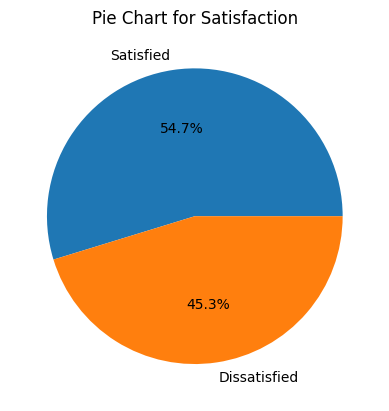

In [ ]:
sat_dict = {    0: 'Dissatisfied',
                1: 'Satisfied'  }

plot_pie(df['satisfaction'], sat_dict, "Pie Chart for Satisfaction")

In [ ]:
gender_counts = df['Gender'].value_counts()
print("\nGender distribution:")
print(gender_counts)


Gender distribution:
0    65703
1    63784
Name: Gender, dtype: int64


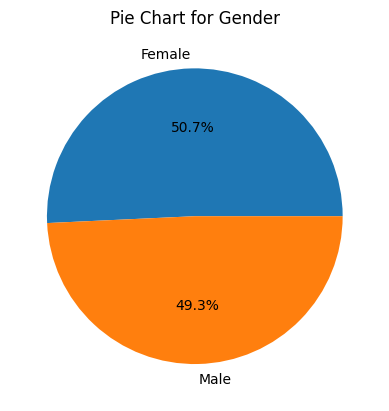

In [ ]:
gender_dict = {    0: 'Female',
                   1: 'Male'  }

plot_pie(df['Gender'], gender_dict, "Pie Chart for Gender")

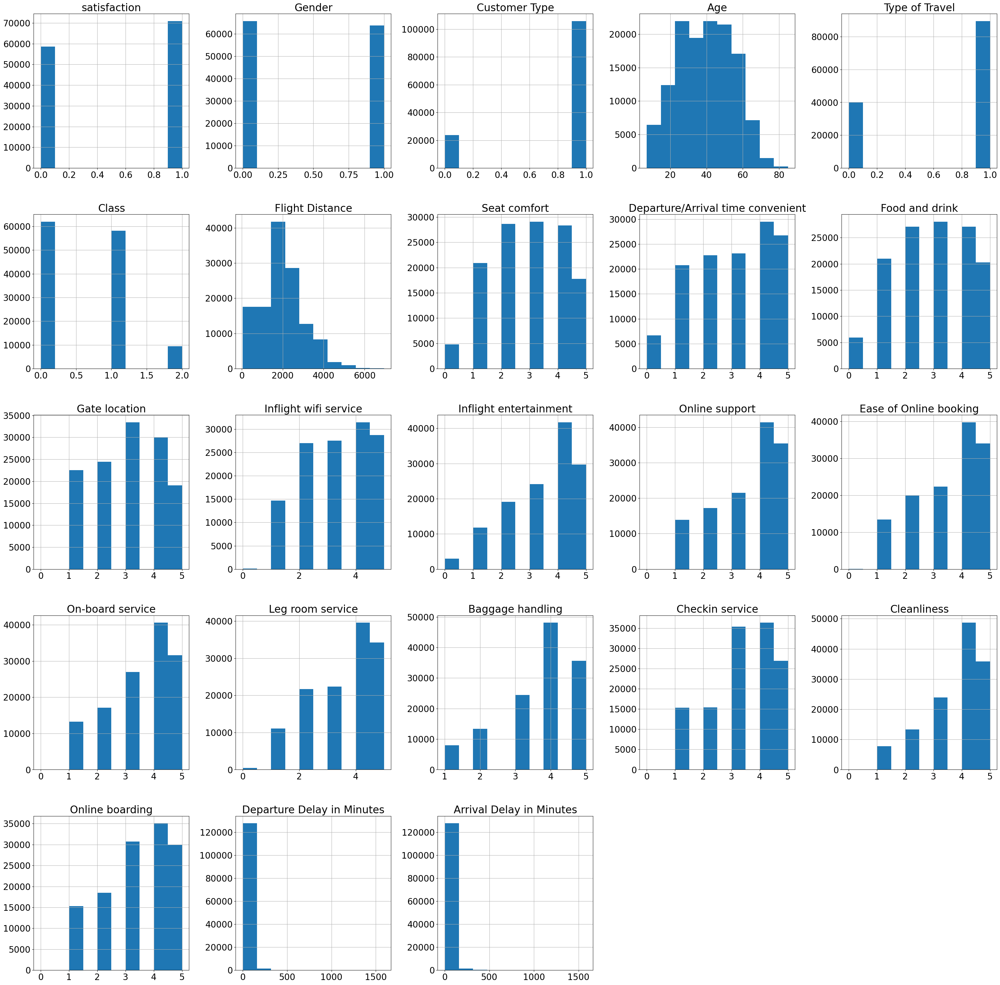

In [ ]:
plt.rc('font', size = 20)
df.hist(figsize=(40,40))
plt.show()

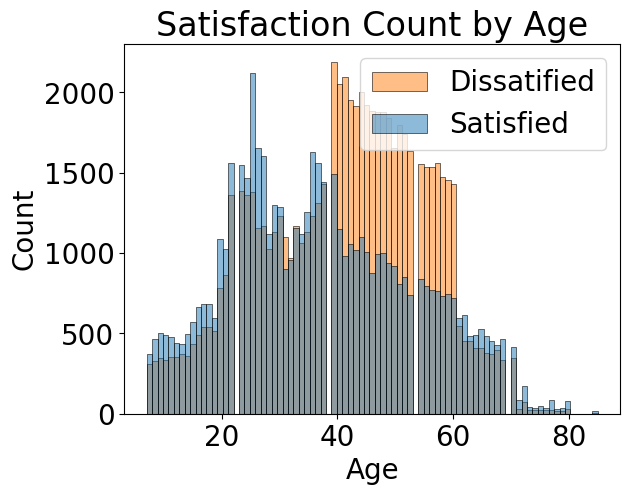

In [ ]:
# To see which age distribution has higher satisfied / dissatified feedback.
sns.histplot(x='Age', hue='satisfaction', data=df)
plt.title('Satisfaction Count by Age')
plt.legend(labels=['Dissatified', 'Satisfied'])
plt.show()

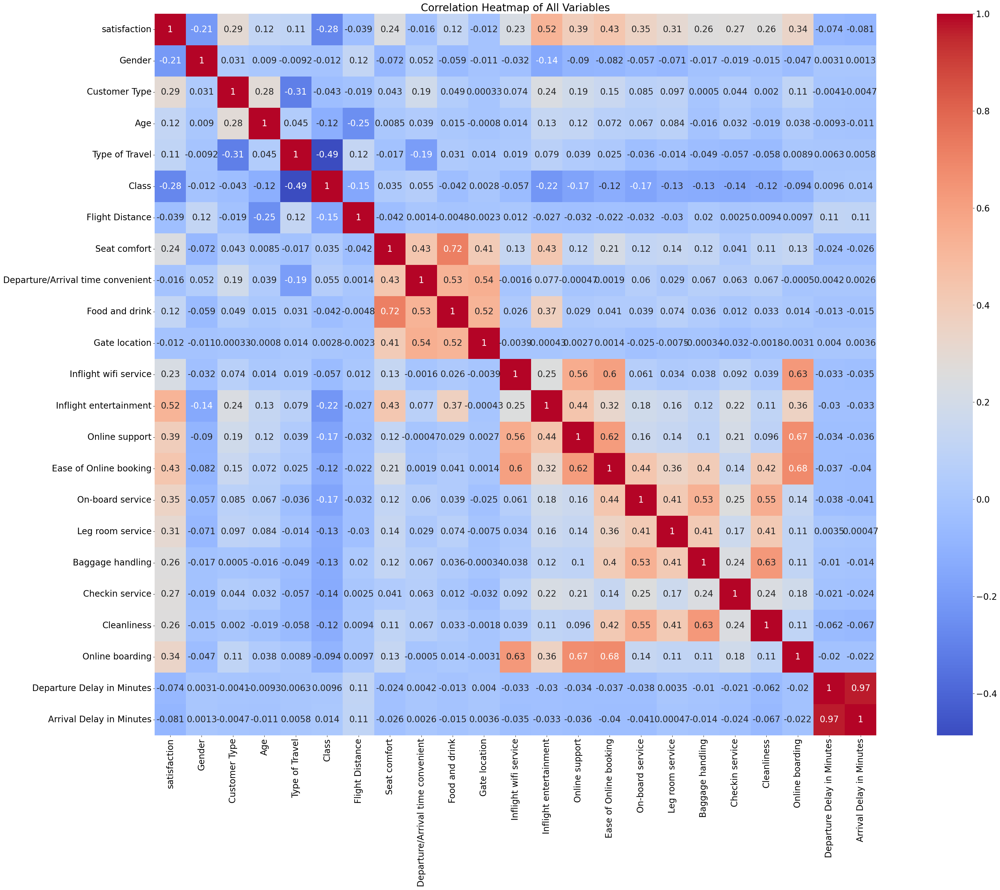

In [ ]:
corr_matrix = df.corr()

plt.figure(figsize=(50, 30))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', square=True)
plt.title('Correlation Heatmap of All Variables')
plt.show()

First, though the class distribution is not fully balanced, we are happy with the percentages between both target classes. The demographic attributes **Gender** and **Age** seem pretty evenly distributed as well. Notably, when plotting **Age** against the class variable **Satisfaction**, we see that there are clear spikes in dissatisfaction for the older ages (between 40-60 years).

Second, we have generate heatmap to see an overall of the correlation between each variables. As expected, there are some highly correlated variables which are **Deparute Delay in Minutes** and **Arrival Delay in Minutes**, with a value of 0.97.

For the **Satisfaction** variable, we now know that the **Inflight Entertainment** actually has the highest effect which is 0.52. However, this is not considered a strong correlation per se.

Though the histogram showed some interesting peaks when plotting **Age** against **Satisfaction**, the correlation is very weak, with only a value of 0.12. Another attribute we expected a stronger correlation with was **Class**. However, we see it only has a negative correlation of -0.28.
Lastly, we see that **Gate location** and **Depature/Arrival time convienent** have the weakest correlation with the **Satisfaction** variable, with values of -0.012 and -0.016 respectively.

### **Data Pre-processing**
- split the dataset into X, Y dataset which Y only contain the label data (satisfication)
- then split the both of the X and Y dataset into train and test dataset for futher training.
- The percentage for each dataset will be Train dataset: 80%, Test dataset: 20%

In [ ]:
feature_names = ["Age", "Gender", "Customer Type", "Type of Travel", "Class",
                 "Flight Distance", "Seat comfort", "Departure/Arrival time convenient",
                 "Food and drink", "Gate location", "Inflight wifi service",
                 "Inflight entertainment", "Online support", "Ease of Online booking",
                 "On-board service", "Leg room service", "Baggage handling",
                 "Checkin service", "Cleanliness", "Online boarding",
                 "Departure Delay in Minutes", "Arrival Delay in Minutes"]

dataT = df[feature_names].values

# Label encoding the target variable
labels = df['satisfaction']
le = sklearn.preprocessing.LabelEncoder()
labels = le.fit_transform(labels)
class_names = le.classes_

In [ ]:
dataT = dataT.astype(float)

np.random.seed(1)
train, test, labels_train, labels_test = sklearn.model_selection.train_test_split(dataT, labels, train_size=0.80)

## **Model Development**
- Black Box
- Glass Box

In [ ]:
### Define the function to plot the loss and accuracy plot for the model.
def plot_acc_loss(results):
  plt.figure(figsize=(15, 5))
  plt.subplot(1,2,1)

  plt.plot(results.history['loss'])
  plt.plot(results.history['val_loss'])
  plt.title('Model Loss ')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'test'], loc='upper left')

  plt.subplot(1,2,2)
  plt.plot(results.history['acc'])
  plt.plot(results.history['val_acc'])
  plt.title('Model Accuracy')
  plt.ylabel('acc')
  plt.xlabel('epoch')
  plt.legend(['train', 'test'], loc='upper left')
  plt.show()

### **Blackbox Approach:**

First model
- To make sure that the datasets are able to train and test in the blackbox model.

The validation accuracy converges at around 80%, which indicates the model is learning from the data.

Epoch 1/25
70/70 [==============================] - 12s 12ms/step - loss: 4.1725 - acc: 0.5398 - val_loss: 0.6594 - val_acc: 0.5616
Epoch 2/25
70/70 [==============================] - 0s 5ms/step - loss: 0.8436 - acc: 0.5816 - val_loss: 0.7398 - val_acc: 0.5776
Epoch 3/25
70/70 [==============================] - 0s 5ms/step - loss: 0.8161 - acc: 0.6279 - val_loss: 0.5582 - val_acc: 0.7238
Epoch 4/25
70/70 [==============================] - 0s 6ms/step - loss: 0.9307 - acc: 0.6067 - val_loss: 0.5613 - val_acc: 0.7081
Epoch 5/25
70/70 [==============================] - 0s 5ms/step - loss: 0.5427 - acc: 0.7178 - val_loss: 0.5236 - val_acc: 0.7487
Epoch 6/25
70/70 [==============================] - 0s 7ms/step - loss: 0.5250 - acc: 0.7326 - val_loss: 0.4968 - val_acc: 0.7739
Epoch 7/25
70/70 [==============================] - 0s 7ms/step - loss: 0.5293 - acc: 0.7300 - val_loss: 0.6307 - val_acc: 0.6437
Epoch 8/25
70/70 [==============================] - 0s 5ms/step - loss: 0.5228 - acc: 0.

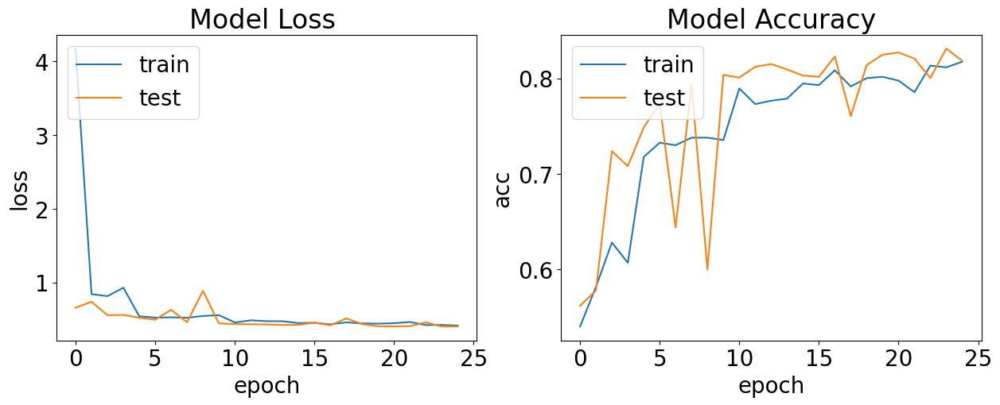

In [ ]:
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

model_first = Sequential()
model_first.add(Dense(1000, input_dim=22, activation='relu'))
model_first.add(Dense(100, activation='relu'))
model_first.add(Dense(100, activation='relu'))
model_first.add(Dense(50, activation='relu'))
model_first.add(Dense(1, activation='sigmoid'))

# Compile model
model_first.compile(loss='binary_crossentropy', optimizer="adam", metrics=['acc'])

# Fit the model, but this time store the history (that is accuracy and loss for each Epoch)
results = model_first.fit(train, labels_train, validation_split=0.33, epochs=25, batch_size=1000, verbose=1, shuffle=True)

# summarize history for loss and accuracy
plot_acc_loss(results)

In [ ]:
print("Accuracy", round(model_first.evaluate(test,labels_test)[1]*100,2), "%")

810/810 [==============================] - 3s 3ms/step - loss: 0.4067 - acc: 0.8190
Accuracy 81.9 %


#### **Individual Model**

##### Cloe Model
Better results than the first model, around 82%

Epoch 1/50
35/35 [==============================] - 1s 15ms/step - loss: 5.4755 - acc: 0.5063 - val_loss: 5.9042 - val_acc: 0.5487
Epoch 2/50
35/35 [==============================] - 0s 9ms/step - loss: 3.0238 - acc: 0.5282 - val_loss: 4.6125 - val_acc: 0.5487
Epoch 3/50
35/35 [==============================] - 0s 7ms/step - loss: 2.0680 - acc: 0.5359 - val_loss: 0.8993 - val_acc: 0.5430
Epoch 4/50
35/35 [==============================] - 0s 7ms/step - loss: 0.6849 - acc: 0.5938 - val_loss: 0.6405 - val_acc: 0.6149
Epoch 5/50
35/35 [==============================] - 0s 7ms/step - loss: 0.6141 - acc: 0.6420 - val_loss: 0.5986 - val_acc: 0.6367
Epoch 6/50
35/35 [==============================] - 0s 8ms/step - loss: 0.9775 - acc: 0.5791 - val_loss: 0.7643 - val_acc: 0.5592
Epoch 7/50
35/35 [==============================] - 0s 7ms/step - loss: 0.6313 - acc: 0.6339 - val_loss: 0.6210 - val_acc: 0.6440
Epoch 8/50
35/35 [==============================] - 0s 7ms/step - loss: 0.5716 - acc: 0.6

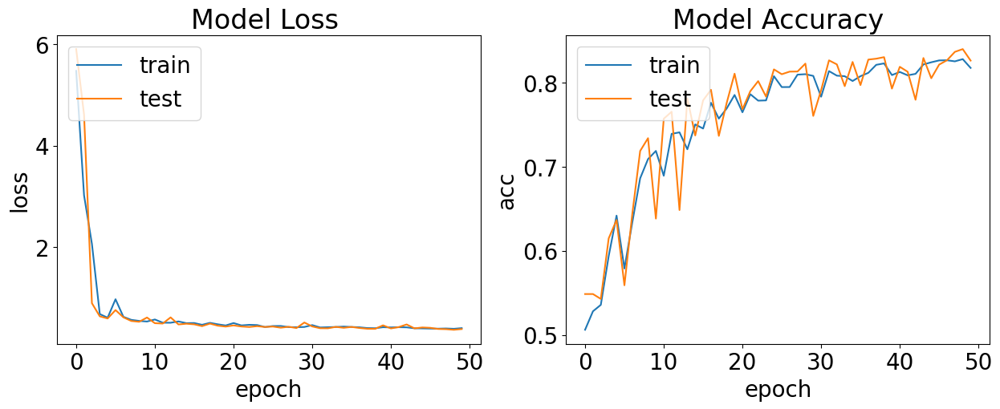

In [ ]:
# Set the seed for reproducibility
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

model = Sequential()
model.add(Dense(1000, input_dim=22, activation='relu'))
model.add(Dense(512, activation='relu'))
model.add(Dense(256, activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

# Compile model with custom learning rate
optimizer = Adam(learning_rate=0.001)
model.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['acc'])

results = model.fit(train, labels_train, validation_split=0.33, epochs=50, batch_size=2000, verbose=1, shuffle=True)

plot_acc_loss(results)

In [ ]:
print("Accuracy", round(model.evaluate(test,labels_test)[1]*100,2), "%")

810/810 [==============================] - 2s 2ms/step - loss: 0.3923 - acc: 0.8263
Accuracy 82.63 %


##### Debby Model

Overall the accuracy converges at around 92%.

Epoch 1/100
104/104 [==============================] - 4s 11ms/step - loss: 9.3816 - acc: 0.5196 - val_loss: 1.0199 - val_acc: 0.5577
Epoch 2/100
104/104 [==============================] - 1s 9ms/step - loss: 1.2894 - acc: 0.5648 - val_loss: 0.6725 - val_acc: 0.6037
Epoch 3/100
104/104 [==============================] - 1s 8ms/step - loss: 1.4173 - acc: 0.5675 - val_loss: 0.6276 - val_acc: 0.6014
Epoch 4/100
104/104 [==============================] - 1s 6ms/step - loss: 0.5954 - acc: 0.6702 - val_loss: 0.5462 - val_acc: 0.7105
Epoch 5/100
104/104 [==============================] - 1s 6ms/step - loss: 0.5404 - acc: 0.7180 - val_loss: 0.5016 - val_acc: 0.7556
Epoch 6/100
104/104 [==============================] - 1s 6ms/step - loss: 0.5538 - acc: 0.7172 - val_loss: 0.4727 - val_acc: 0.7799
Epoch 7/100
104/104 [==============================] - 1s 5ms/step - loss: 0.4875 - acc: 0.7657 - val_loss: 0.4565 - val_acc: 0.7983
Epoch 8/100
104/104 [==============================] - 1s 5ms/step -

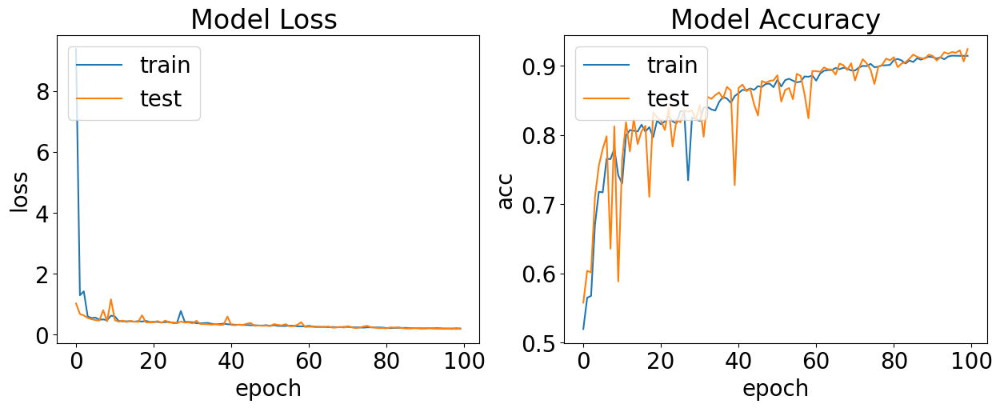

In [ ]:
# Set the seed for reproducibility
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

model = Sequential()
model.add(Dense(1000, input_dim=22, activation='relu'))
model.add(Dense(500, activation='relu'))
model.add(Dense(100, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

# Compile model
model.compile(loss='binary_crossentropy', optimizer="adam", metrics=['acc'])

# Fit the model, but this time store the history (that is accuracy and loss for each Epoch)
results = model.fit(train, labels_train, validation_data=(test, labels_test), epochs=100, batch_size=1000, verbose=1, shuffle=True)

# summarize history for loss
plot_acc_loss(results)

In [ ]:
print("Accuracy", round(model.evaluate(test,labels_test)[1]*100,2), "%")

810/810 [==============================] - 2s 2ms/step - loss: 0.1819 - acc: 0.9246
Accuracy 92.46 %


##### Zaur Model

The validation accuracy is around 87%

Epoch 1/75
35/35 [==============================] - 2s 24ms/step - loss: 3.1992 - acc: 0.5028 - val_loss: 1.9723 - val_acc: 0.5487
Epoch 2/75
35/35 [==============================] - 0s 14ms/step - loss: 0.8547 - acc: 0.5362 - val_loss: 0.6827 - val_acc: 0.5649
Epoch 3/75
35/35 [==============================] - 0s 14ms/step - loss: 0.6821 - acc: 0.5697 - val_loss: 0.6605 - val_acc: 0.5978
Epoch 4/75
35/35 [==============================] - 0s 14ms/step - loss: 0.6606 - acc: 0.5881 - val_loss: 0.6430 - val_acc: 0.6209
Epoch 5/75
35/35 [==============================] - 0s 14ms/step - loss: 0.6525 - acc: 0.5970 - val_loss: 0.6210 - val_acc: 0.6063
Epoch 6/75
35/35 [==============================] - 0s 14ms/step - loss: 0.6276 - acc: 0.6293 - val_loss: 0.6416 - val_acc: 0.6362
Epoch 7/75
35/35 [==============================] - 1s 16ms/step - loss: 0.6327 - acc: 0.6407 - val_loss: 0.5683 - val_acc: 0.6943
Epoch 8/75
35/35 [==============================] - 0s 14ms/step - loss: 0.5781 - a

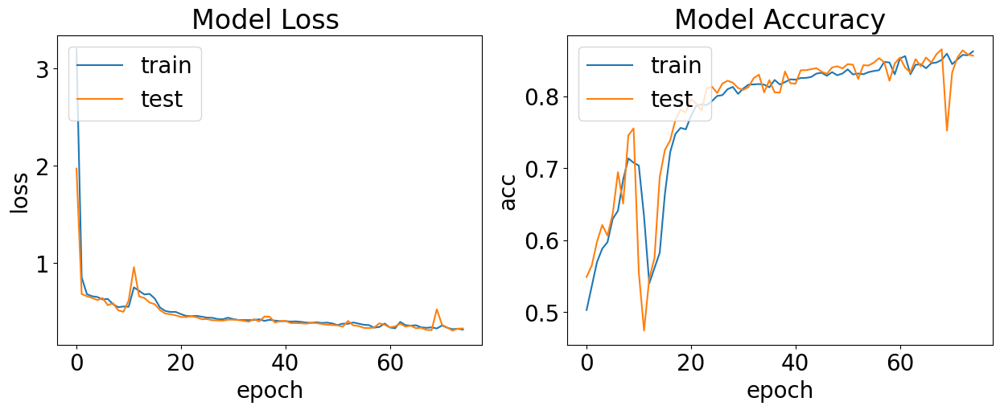

In [ ]:
# Set the seed for reproducibility
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

model = Sequential()
model.add(Dense(2048, input_dim=22, activation='relu'))
model.add(Dense(1024, activation='relu'))
model.add(Dense(512, activation='relu'))
model.add(Dense(256, activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

# Compile model with custom learning rate
optimizer = Adam(learning_rate=0.001)
model.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['acc'])

results = model.fit(train, labels_train, validation_split=0.33, epochs=75, batch_size=2000, verbose=1, shuffle=True)

plot_acc_loss(results)

In [ ]:
print("Accuracy", round(model.evaluate(test,labels_test)[1]*100,2), "%")

810/810 [==============================] - 2s 3ms/step - loss: 0.3310 - acc: 0.8548
Accuracy 85.48 %


#### **Final Model**

Of the three models, we continued with Debby's model. The validation accuracy converges at around 92%, this gives us the best rate.

Epoch 1/100
104/104 [==============================] - 10s 8ms/step - loss: 1.7595 - acc: 0.5406 - val_loss: 0.7236 - val_acc: 0.5451
Epoch 2/100
104/104 [==============================] - 1s 6ms/step - loss: 0.6376 - acc: 0.6346 - val_loss: 0.5707 - val_acc: 0.6955
Epoch 3/100
104/104 [==============================] - 1s 5ms/step - loss: 0.6319 - acc: 0.6607 - val_loss: 0.5251 - val_acc: 0.7334
Epoch 4/100
104/104 [==============================] - 1s 5ms/step - loss: 0.5639 - acc: 0.7104 - val_loss: 0.5487 - val_acc: 0.7188
Epoch 5/100
104/104 [==============================] - 1s 6ms/step - loss: 0.5211 - acc: 0.7367 - val_loss: 0.5058 - val_acc: 0.7565
Epoch 6/100
104/104 [==============================] - 1s 5ms/step - loss: 0.5475 - acc: 0.7270 - val_loss: 0.4518 - val_acc: 0.7930
Epoch 7/100
104/104 [==============================] - 1s 5ms/step - loss: 0.5116 - acc: 0.7509 - val_loss: 0.4451 - val_acc: 0.7940
Epoch 8/100
104/104 [==============================] - 1s 5ms/step -

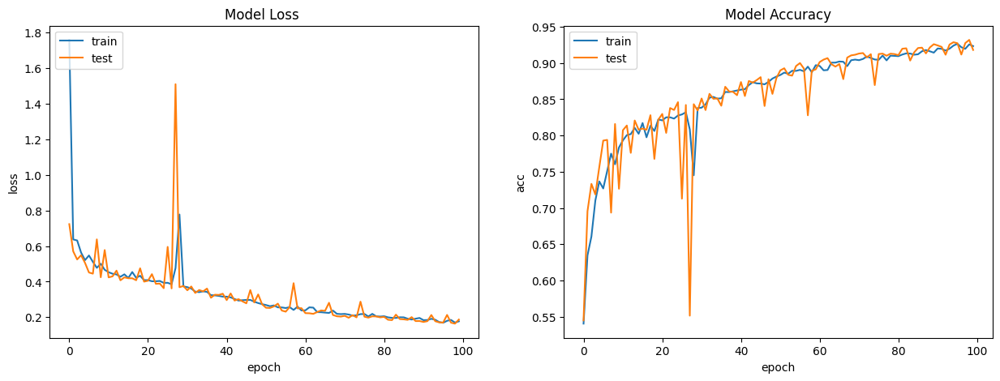

810/810 [==============================] - 2s 2ms/step - loss: 0.1872 - acc: 0.9181
Accuracy 91.81 %


In [ ]:
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed) # for TF this needs to be run per cell.

model = Sequential()
model.add(Dense(1000, input_dim=22, activation='relu'))
model.add(Dense(500, activation='relu'))
model.add(Dense(100, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

# Compile model
model.compile(loss='binary_crossentropy', optimizer="adam", metrics=['acc'])

# Fit the model, but this time store the history (that is accuracy and loss for each Epoch)
results = model.fit(train, labels_train, validation_data=(test, labels_test), epochs=100, batch_size=1000, verbose=1, shuffle=True)

# summarize history for loss
plot_acc_loss(results)
print("Accuracy", round(model.evaluate(test,labels_test)[1]*100,2), "%")

### **Glassbox Approach: Decision Trees**

In this section, we are exploring the concept of the "Glassbox" approach, which aims to balance model accuracy and explainability. This approach involves using a transparent and interpretable model to achieve a trade-off between understanding how predictions are made and achieving a high level of accuracy.

We use a Decision Tree classifier:

In [ ]:
model_dt = DecisionTreeClassifier()
model_dt.fit(train, labels_train)
accuracy = model_dt.score(test, labels_test)
print("Accuracy:", round(accuracy * 100, 2), "%")

Accuracy: 94.18 %


In [ ]:
# Visualise the tree
text_representation = tree.export_text(model_dt,
                                       feature_names = feature_names)
print(text_representation)

|--- Inflight entertainment <= 3.50
|   |--- Seat comfort <= 3.50
|   |   |--- Seat comfort <= 0.50
|   |   |   |--- Ease of Online booking <= 0.50
|   |   |   |   |--- class: 0
|   |   |   |--- Ease of Online booking >  0.50
|   |   |   |   |--- class: 1
|   |   |--- Seat comfort >  0.50
|   |   |   |--- Class <= 0.50
|   |   |   |   |--- Ease of Online booking <= 3.50
|   |   |   |   |   |--- Online boarding <= 4.50
|   |   |   |   |   |   |--- Gate location <= 3.50
|   |   |   |   |   |   |   |--- Checkin service <= 4.50
|   |   |   |   |   |   |   |   |--- Online support <= 4.50
|   |   |   |   |   |   |   |   |   |--- Cleanliness <= 4.50
|   |   |   |   |   |   |   |   |   |   |--- Baggage handling <= 4.50
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 25
|   |   |   |   |   |   |   |   |   |   |--- Baggage handling >  4.50
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 7
|   |   |   |   |   |   |   |   |   |--- Cleanliness >

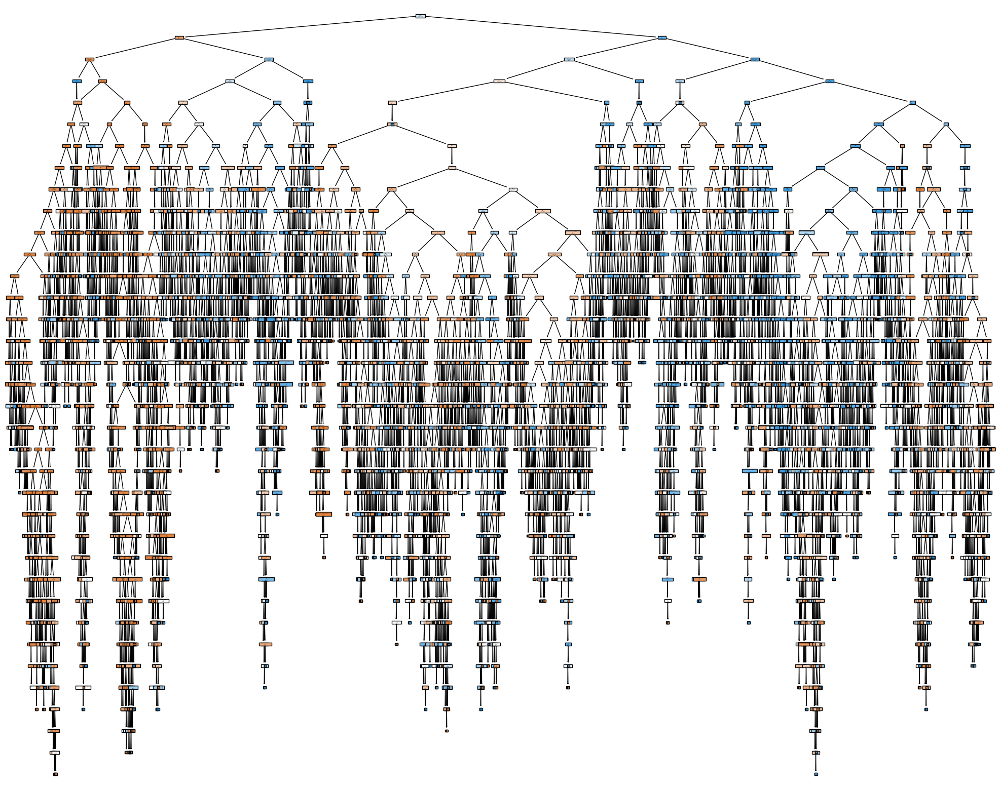

In [ ]:
colNames = df.columns.tolist()

fig = plt.figure(figsize=(25,20))
_ = tree.plot_tree(model_dt,
                   feature_names=colNames,
                   class_names=["SAT", "UNSAT"],
                   filled=True,
                   impurity=False, label=None)

#### **Interpretable Decision Tree with Limited Depth (n=2)**

In this section, we demonstrate the construction of an interpretable Decision Tree model with a limited maximum depth. This approach enhances model interpretability by creating a more concise tree that captures essential decision points.


In [ ]:
model_dt2 = DecisionTreeClassifier(max_depth=2)
model_dt2.fit(train, labels_train)
accuracy = model_dt2.score(test, labels_test)
print("Accuracy:", round(accuracy * 100, 2), "%")

Accuracy: 82.92 %


In [ ]:
text_representation = tree.export_text(model_dt2,
                                       feature_names = feature_names)
print(text_representation)

|--- Inflight entertainment <= 3.50
|   |--- Seat comfort <= 3.50
|   |   |--- class: 0
|   |--- Seat comfort >  3.50
|   |   |--- class: 1
|--- Inflight entertainment >  3.50
|   |--- Ease of Online booking <= 3.50
|   |   |--- class: 1
|   |--- Ease of Online booking >  3.50
|   |   |--- class: 1



#### **Results**

The Decision Tree has learned a set of rules to classify instances into two classes (0 and 1) based on features. It identifies conditions under which customers are more likely to be satisfied (class 1) or dissatisfied (class 0).

**Inflight Entertainment:**

If the "Inflight entertainment" score is less than or equal to 3.50, customers are directed to the left branch.
This suggests that customers who rate the inflight entertainment experience poorly (less than or equal to 3.50) might be more likely to have a negative perception overall.

**Seat Comfort (Low):**

For customers in the left branch (unsatisfied with inflight entertainment), if "Seat comfort" is also rated as less than or equal to 3.50, they are assigned to class 0 (UNSAT).
This indicates that customers who are unhappy with both inflight entertainment and seat comfort are predicted to be dissatisfied with their overall experience.

**Seat Comfort (Moderate):**

For customers in the left branch (unsatisfied with inflight entertainment), if "Seat comfort" is rated higher than 3.50, they are assigned to class 1 (SAT).
This suggests that despite being dissatisfied with inflight entertainment, if seat comfort is better, customers are still predicted to perceive their experience as satisfactory.

**Ease of Online Booking (Low):**

For customers in the right branch (satisfied with inflight entertainment), if "Ease of Online booking" is rated as less than or equal to 3.50, they are assigned to class 1 (SAT).
This implies that customers who are content with inflight entertainment but find online booking difficult, are still predicted to have an overall positive experience.

**Ease of Online Booking (Moderate/High):**

For customers in the right branch (satisfied with inflight entertainment), if "Ease of Online booking" is rated higher than 3.50, they are assigned to class 1 (SAT).
This suggests that if customers are satisfied with inflight entertainment and find online booking easy, they are predicted to have a positive perception overall.


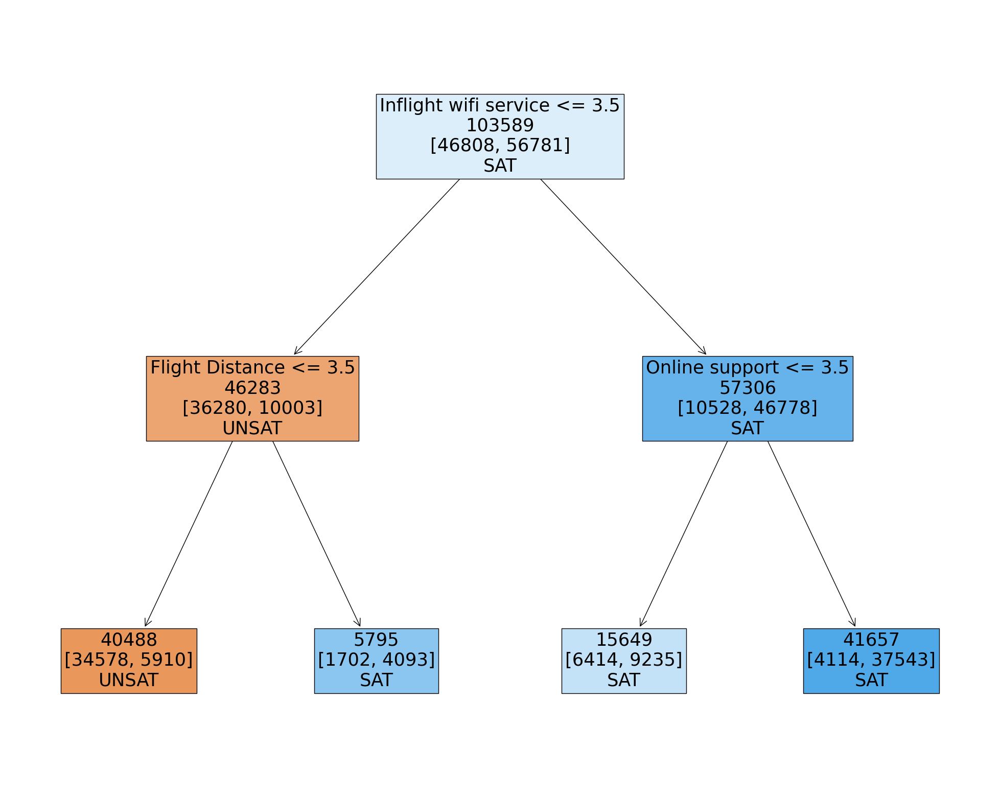

In [ ]:
fig = plt.figure(figsize=(25,20))
_ = tree.plot_tree(model_dt2,
                   feature_names=colNames,
                   class_names=["UNSAT", "SAT"],
                   filled=True,
                   impurity=False, label=None)

### **Model Extra**
- Model with "softmax" and "sparse_categorical_crossentropy"

The result of this model is actually pretty similar with our final model which using "Sigmoid" and "Binary_crossentropy" which overall around 91%.

Epoch 1/100
104/104 [==============================] - 3s 9ms/step - loss: 9.0757 - acc: 0.5161 - val_loss: 1.1040 - val_acc: 0.5588
Epoch 2/100
104/104 [==============================] - 1s 7ms/step - loss: 2.2330 - acc: 0.5509 - val_loss: 0.8201 - val_acc: 0.5500
Epoch 3/100
104/104 [==============================] - 1s 8ms/step - loss: 0.8360 - acc: 0.5963 - val_loss: 0.5962 - val_acc: 0.6427
Epoch 4/100
104/104 [==============================] - 1s 8ms/step - loss: 0.6945 - acc: 0.6610 - val_loss: 0.5151 - val_acc: 0.7537
Epoch 5/100
104/104 [==============================] - 1s 8ms/step - loss: 0.5907 - acc: 0.6887 - val_loss: 0.4862 - val_acc: 0.7761
Epoch 6/100
104/104 [==============================] - 1s 6ms/step - loss: 0.5557 - acc: 0.7160 - val_loss: 0.5532 - val_acc: 0.6914
Epoch 7/100
104/104 [==============================] - 1s 6ms/step - loss: 0.5601 - acc: 0.7254 - val_loss: 0.5125 - val_acc: 0.7498
Epoch 8/100
104/104 [==============================] - 1s 6ms/step - 

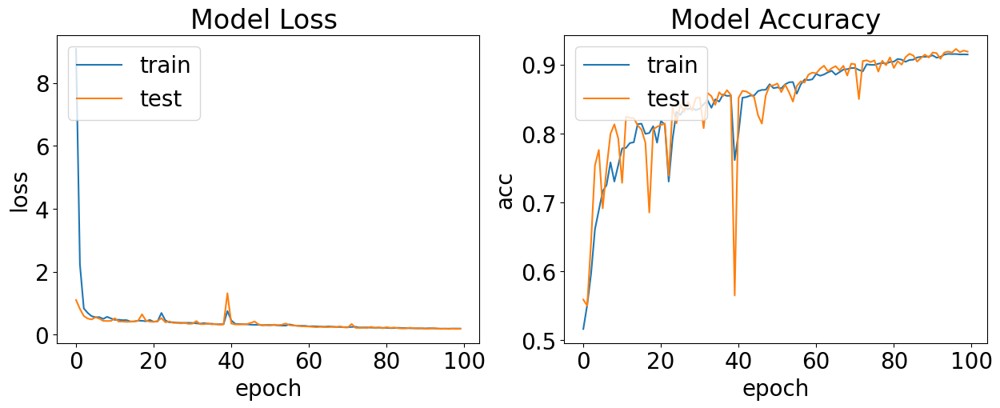

810/810 [==============================] - 2s 2ms/step - loss: 0.1890 - acc: 0.9190
Accuracy 91.9 %


In [ ]:
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed) # for TF this needs to be run per cell.

model_extra = Sequential()
model_extra.add(Dense(1000, input_dim=22, activation='relu'))
model_extra.add(Dense(500, activation='relu'))
model_extra.add(Dense(100, activation='relu'))
model_extra.add(Dense(50, activation='relu'))
model_extra.add(Dense(10, activation='relu'))
model_extra.add(Dense(2, activation='softmax'))

# Compile model
model_extra.compile(loss='sparse_categorical_crossentropy', optimizer="adam", metrics=['acc'])

# Fit the model, but this time store the history (that is accuracy and loss for each Epoch)
results = model_extra.fit(train, labels_train, validation_data=(test, labels_test), epochs=100, batch_size=1000, verbose=1, shuffle=True)

# summarize history for loss
plot_acc_loss(results)
print("Accuracy", round(model_extra.evaluate(test,labels_test)[1]*100,2), "%")

## **Model Performance Evaluation**

### **Evaluation Metrics for Blackbox**

3238/3238 [==============================] - 6s 2ms/step
Accuracy: 92.2 %
Precision: 0.9689
Recall: 0.8863
F1-Score: 0.9257
Confusion Matrix:
[[45191  1617]
 [ 6458 50323]]


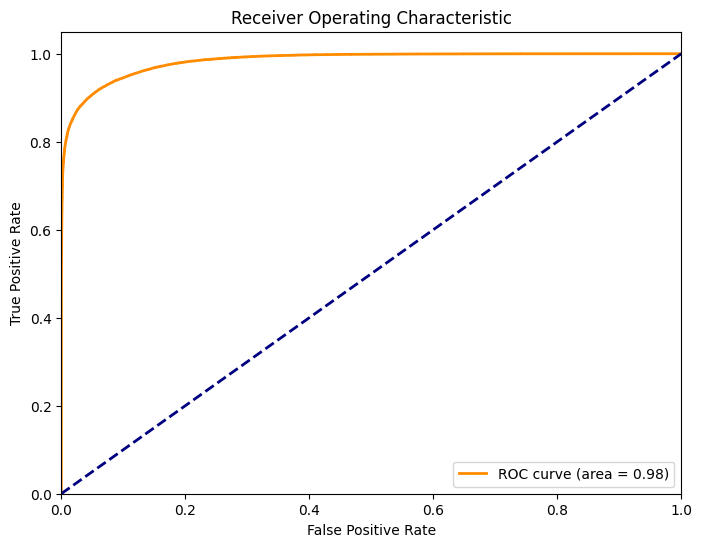

In [ ]:
# Predictions
train_pred = model.predict(train)
train_pred_labels = (train_pred > 0.5).astype(int)

# Accuracy
accuracy = accuracy_score(labels_train, train_pred_labels)
print("Accuracy:", round(accuracy * 100, 2), "%")

# Precision and Recall
precision = precision_score(labels_train, train_pred_labels)
recall = recall_score(labels_train, train_pred_labels)
print("Precision:", round(precision, 4))
print("Recall:", round(recall, 4))

# F1-Score
f1 = f1_score(labels_train, train_pred_labels)
print("F1-Score:", round(f1, 4))

# Confusion Matrix
conf_matrix = confusion_matrix(labels_train, train_pred_labels)
print("Confusion Matrix:")
print(conf_matrix)

# ROC Curve and AUC
fpr, tpr, thresholds = roc_curve(labels_train, train_pred)
roc_auc = roc_auc_score(labels_train, train_pred)
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()

- Accuracy: The model's accuracy on the training data is 92.81%. This is very high.
- Precision: Precision is 0.9631, indicating 96.31% of predicted positives were accurate and truly positive instances.
- Recall: Recall is 0.9034, meaning 90.34% of actual positives were detected.
- F1-Score: The F1-Score is 0.9323, balancing precision and recall.

- Confusion Matrix: It shows 44842 true negatives, 51294 true positives, 5487 false negatives, and 1966 false positives.

- ROC Curve and AUC: The ROC curve's area is 0.98, signifying strong class differentiation.

#### **Loss & Accuracy Plot**

We trained a neural network model on our dataset. The goal was to understand how the model's performance evolved over the training epochs.

1. **Model Training:** We defined a neural network architecture with multiple hidden layers and an output layer for binary classification. The model was trained using the `fit` function, which iteratively adjusts the model's weights to minimize the loss function.

2. **Training Metrics:** During training, we tracked two important metrics:
   - **Loss:** The loss function quantifies how far the model's predictions are from the actual labels. The goal is to minimize this value.
   - **Accuracy:** Accuracy measures the proportion of correctly predicted instances to the total number of instances.

3. **Validation:** To ensure that our model is performing well on data it hasn't seen during training, we used a separate validation dataset. The validation metrics provide insight into the model's generalization to new data.

4. **Results Plotting:** After training, we plotted the training and validation loss, as well as the training and validation accuracy, over the course of the training epochs.


#### **Analyzing Training Results**

1. The training accuracy steadily increases, which suggests that the model is learning from the training data and improving its ability to make accurate predictions.

2. The validation accuracy (val_acc) also shows an increasing trend, reaching around 92.81% by the end of training. This indicates that the model is generalizing well to the validation data and is not overfitting.

3. The loss values (loss and val_loss) decrease during training, which is expected as the model learns to minimize the loss function.

4. Though the true positives are higher in numbers, the confusion matrix tells us that the model actually makes more mistakes for the positive class. That is, the false negative rate is 9.6% where the false positive rate is 4.2%. This means that the model incorrectly identifies 9.6% of satisfied customers as unsatisfied.
This is not a major issue, as the airline probably learns more from unsatisfied customers (as long as the airline is aware of this model flaw). If the model is good at correctly identifiying the unsatisfied customers, the airline can learn from the predictions and adjust their services accordingly.

### **Evaluation Metrics for Glassbox**

In this part, we just show simple classification report which include the precision, recall and f1-score for the evaluation metrics for Glassbox model as we have already discuss clearly earlier during the implementation of Glassbox model on above.

In [ ]:
predictions = model_dt.predict(test)
report = classification_report(labels_test, predictions)
print(report)

              precision    recall  f1-score   support

           0       0.93      0.94      0.94     11797
           1       0.95      0.94      0.95     14101

    accuracy                           0.94     25898
   macro avg       0.94      0.94      0.94     25898
weighted avg       0.94      0.94      0.94     25898



## **XAI for the model & Discussion on the model performance and Explainability**

### **LIME Explanation using Softmax and Sparse Categorical Crossentropy**

In this code snippet, we are using the LIME (Local Interpretable Model-agnostic Explanations) technique to explain the predictions of a model trained with softmax activation and sparse categorical crossentropy loss.

### Output

-- The output shows the original prediction probabilities for these two classes: "Satisfied" (with a probability of 0.55) and "Unsatisfied" (with a probability of 0.45).  

- Class 0: 0.45
- Class 1: 0.55

- Each feature along with its value and the range it falls into:
  - Age: 54.00
  - Gender: 1.00
  - Customer Type: 1.00
  - Type of Travel: 1.00
  - Class: 0.00
  - Flight Distance: 515.00
  - Seat comfort: 3.00
  - Departure/Arrival time convenient: 5.00
  - Food and drink: 4.00
  - Gate location: 4.00
  - Inflight wifi service: 4.00
  - Inflight entertainment: 4.00
  - Online support: 3.00
  - Ease of Online booking: 3.00
  - On-board service: 3.00
  - Leg room service: 3.00
  - Baggage handling: 3.00
  - Checkin service: 4.00
  - Cleanliness: 3.00
  - Online boarding: 1.00
  - Departure Delay in Minutes: 9.00
  - Arrival Delay in Minutes: 17.00

The feature values and their corresponding ranges contribute to the model's prediction for the instance.

In [ ]:
## with softmax and sparse_categorical_crossentropy
explainer = lime.lime_tabular.LimeTabularExplainer(train, feature_names=feature_names, class_names=class_names, kernel_width=3)

exp = explainer.explain_instance(test[1], model_extra.predict, num_features=10)
exp.show_in_notebook(show_all=True)

157/157 [==============================] - 0s 2ms/step


### **LIME Explanation using binary crossentropy and sigmoid**

In [ ]:
# ***** when using binary crossentropy *****
explainer = lime.lime_tabular.LimeTabularExplainer(train,
                                                   feature_names = feature_names,
                                                   class_names=['Dissastified', 'Satisfied'],
                                                   kernel_width = 5)

### Define function for the prediction method to resize the return of predict function return from 1 to 2 array.
###   This is because the lime explantion is required to have 2 instance in the predict method.
def my_predict(x):
    pred = model.predict(x)
    format_pred = np.concatenate([1.0-pred, pred], axis=1)
    return format_pred

exp = explainer.explain_instance(test[0], my_predict, num_features=5)
exp.show_in_notebook(show_all=True)

157/157 [==============================] - 0s 2ms/step


The prediction probabilities indicate the model's confidence in each class: **"Dissatisfied"** (with a probability of 0.00) and **"Satisfied"** (with a probability of 1.00). This means that the model is very confident that the customer's experience is **"Satisfied."**

Looking at these values, we can interpret that the customer's age is 67, indicating a potentially positive influence on the prediction. On the other hand, features like **"Gender"** and **"Type of Travel"** have lower values, suggesting that they may have less influence on the prediction.


#### **More example for the Correct and Incorrect prediction in LIME explantion**

In [ ]:
# predict the dataset and keep the output into correct and incorrect list
preds = model.predict(test)
pred_classes = np.where(preds > 0.5, 1, 0)
true_preds = np.argwhere(pred_classes.flatten() == labels_test).flatten()
false_preds = np.argwhere(pred_classes.flatten() != labels_test).flatten()

size_exp = 5
idx_true = np.random.choice(true_preds, size=size_exp, replace=False)
idx_false = np.random.choice(false_preds, size=size_exp, replace=False)

810/810 [==============================] - 2s 2ms/step


##### **5 example of random Correct prediction**

In [ ]:
for num in idx_true:
    exp = explainer.explain_instance(test[num], my_predict, num_features=5)

    print("\nTrue Prediction:", num)
    print("Predicted Class:", pred_classes[num])
    print("Actual Class:", [labels_test[num]])
    exp.show_in_notebook(show_all=True)

157/157 [==============================] - 0s 2ms/step

True Prediction: 8970
Predicted Class: [1]
Actual Class: [1]


157/157 [==============================] - 0s 2ms/step

True Prediction: 25125
Predicted Class: [0]
Actual Class: [0]


157/157 [==============================] - 1s 4ms/step

True Prediction: 1850
Predicted Class: [0]
Actual Class: [0]


157/157 [==============================] - 1s 5ms/step

True Prediction: 15783
Predicted Class: [0]
Actual Class: [0]


157/157 [==============================] - 1s 5ms/step

True Prediction: 24748
Predicted Class: [1]
Actual Class: [1]


These results are showing 5 examples of instances where the model made correct predictions. For each example, the following information is presented:

* True Prediction: The index of the example in the dataset.
* Predicted Class: The class predicted by the model for this example (0 for "Dissatisfied" and 1 for "Satisfied").
* Actual Class: The true class label for this example.
* Prediction probabilities: The predicted probabilities for both classes ("Dissatisfied" and "Satisfied").
* Explanation: Lime's explanation for the prediction, showing the top contributing features along with their impact.

##### **5 example of random Incorrect prediction**

In [ ]:
for num in idx_false:
    exp = explainer.explain_instance(test[num], my_predict, num_features=5)

    print("\nFalse Prediction:", num)
    print("Predicted Class:", pred_classes[num])
    print("Actual Class:", [labels_test[num]])
    exp.show_in_notebook(show_all=True)

157/157 [==============================] - 0s 2ms/step

False Prediction: 11763
Predicted Class: [0]
Actual Class: [1]


157/157 [==============================] - 0s 3ms/step

False Prediction: 16867
Predicted Class: [0]
Actual Class: [1]


157/157 [==============================] - 1s 3ms/step

False Prediction: 18009
Predicted Class: [1]
Actual Class: [0]


157/157 [==============================] - 1s 3ms/step

False Prediction: 3607
Predicted Class: [0]
Actual Class: [1]


157/157 [==============================] - 0s 3ms/step

False Prediction: 13995
Predicted Class: [0]
Actual Class: [1]


These results show 5 examples where the model made incorrect predictions (false predictions). For each example, the following information is presented:

* False Prediction: The index of the example in the dataset.
* Predicted Class: The class predicted by the model for this example (0 for "Dissatisfied" and 1 for "Satisfied").
* Actual Class: The true class label for this example.
* Prediction probabilities: The predicted probabilities for both classes ("Dissatisfied" and "Satisfied").
* Explanation: Lime's explanation for the prediction, showing the top contributing features along with their impact.

### **SHAP explanation**
- 5 example include 3 correct and 2 incorrect prediction

In [ ]:
%matplotlib inline
# This can be very compute consuming and OOM erros
shapML = ShapKernel(my_predict,
                    train[:100],
                    feature_names=feature_names)
shap_local = shapML.explain_local(test[20:25], labels_test[20:25])
show(shap_local, 0)

1/1 [==============================] - 0s 67ms/step


  0%|          | 0/5 [00:00<?, ?it/s]

1/1 [==============================] - 0s 29ms/step


In [ ]:
xplainer = shap.KernelExplainer(model, train[:100])
shap_values = xplainer.shap_values(test[20:25])

  0%|          | 0/5 [00:00<?, ?it/s]

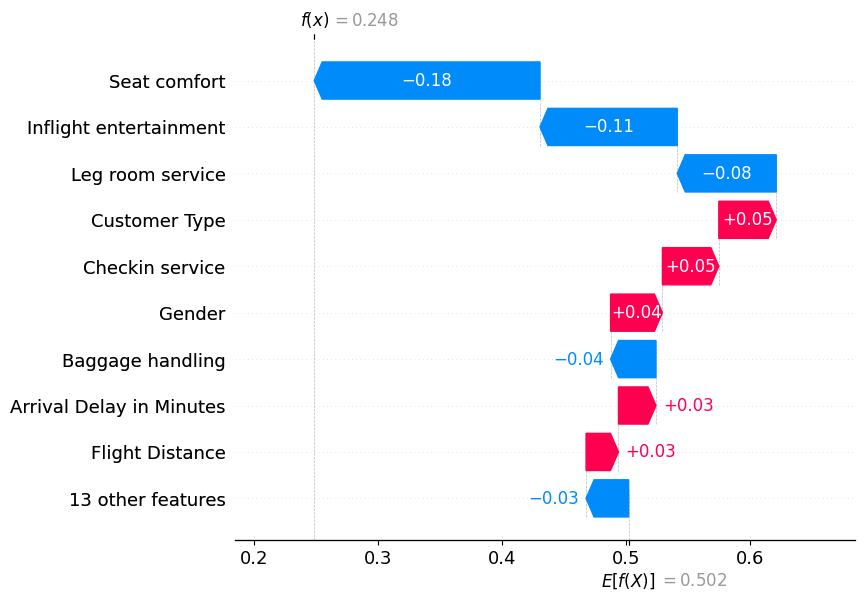

In [ ]:
shap.initjs()
shap.plots._waterfall.waterfall_legacy(xplainer.expected_value[0], shap_values[0][0], feature_names=feature_names)

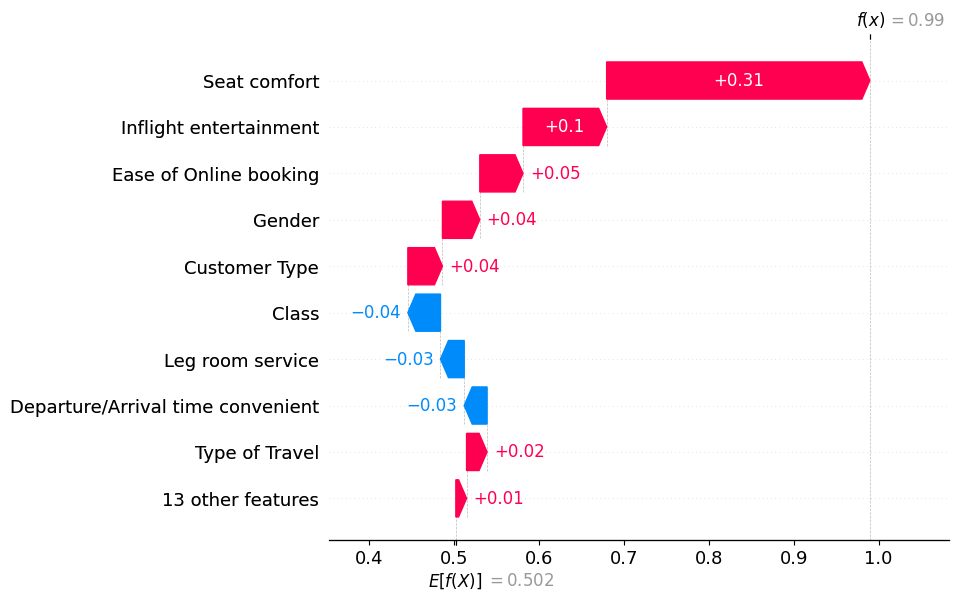

In [ ]:
shap.initjs()
shap.plots._waterfall.waterfall_legacy(xplainer.expected_value[0], shap_values[0][1], feature_names=feature_names)

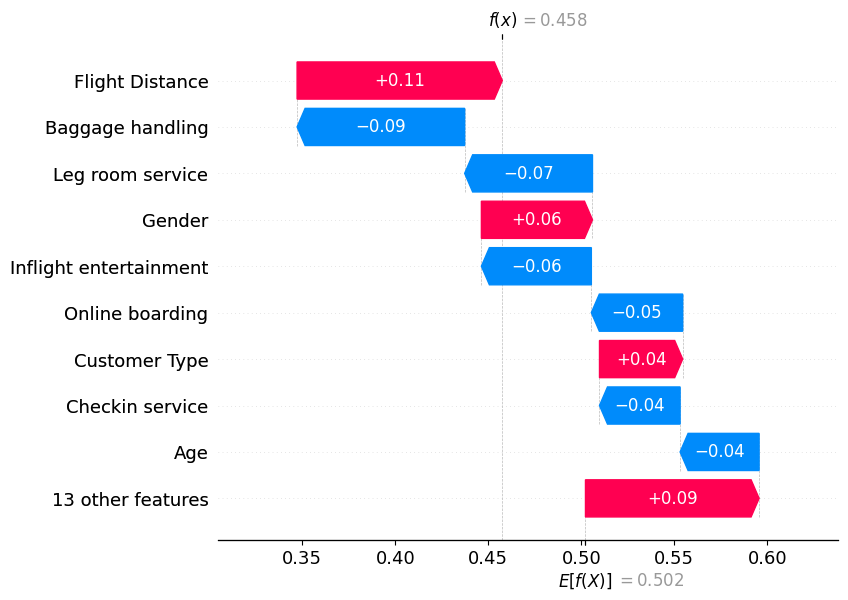

In [ ]:
shap.initjs()
shap.plots._waterfall.waterfall_legacy(xplainer.expected_value[0], shap_values[0][2], feature_names=feature_names)

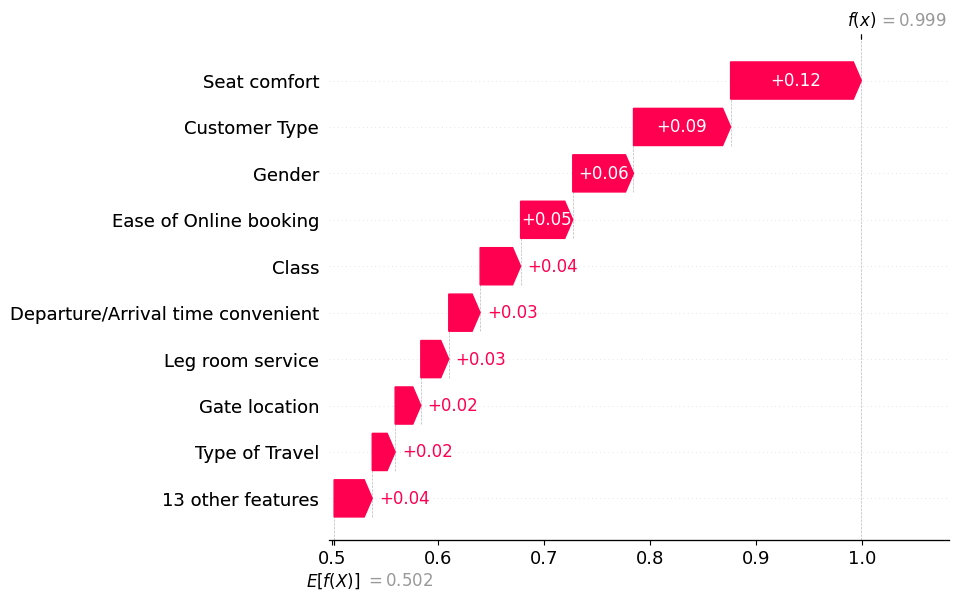

In [ ]:
shap.initjs()
shap.plots._waterfall.waterfall_legacy(xplainer.expected_value[0], shap_values[0][3], feature_names=feature_names)

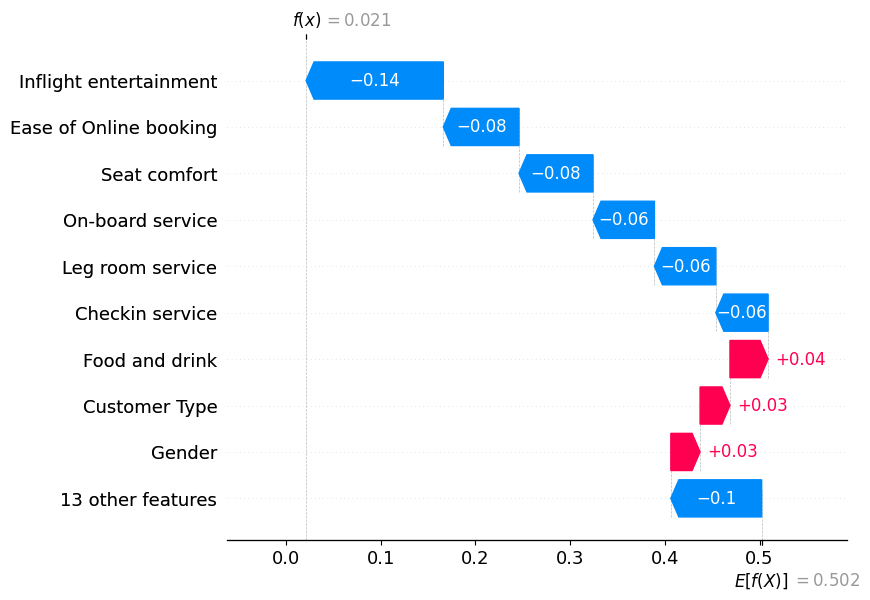

In [ ]:
shap.initjs()
shap.plots._waterfall.waterfall_legacy(xplainer.expected_value[0], shap_values[0][4], feature_names=feature_names)

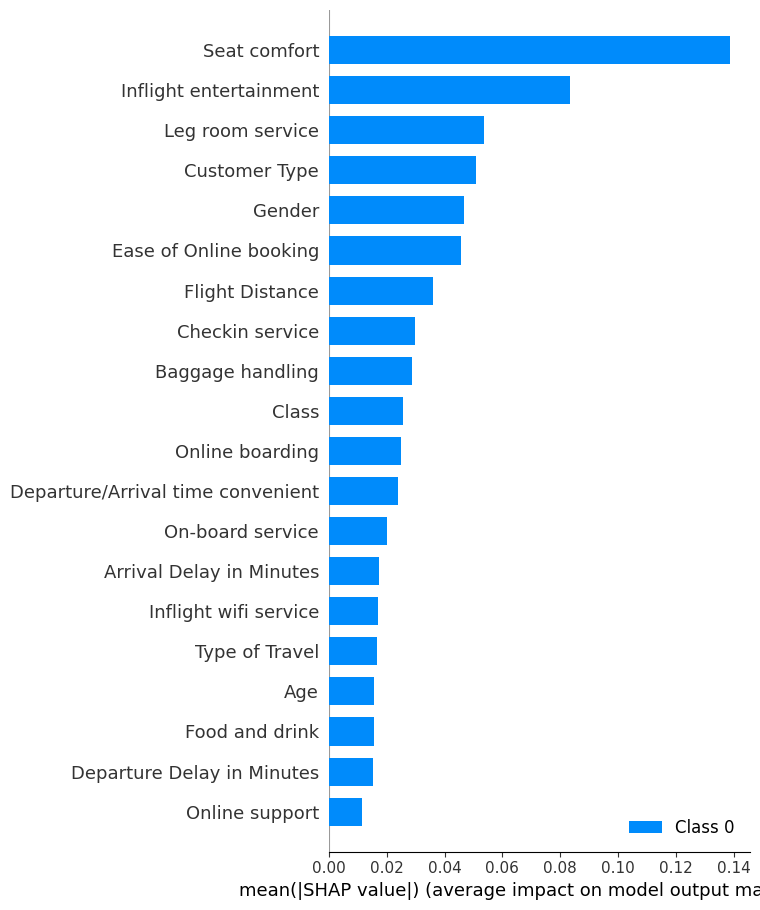

In [ ]:
shap.summary_plot(shap_values, test, feature_names=feature_names, plot_type="bar")

**XAI Explaination**

For both LIME and SHAP, the graphs show that **seat comfort** and **inflight entertainment** are the biggest contributing factors. That is, these factors have the biggest weights for both classes. Meaning that if either is negative (bad seats and/or no entertainment), it has a big negative impact. If they are positive (great seat and/or a lot of entertainment), they have a large positive impact. For example, the last SHAP graph shows that the average impact of the model's output for class 0 (dissatisfied) for **seat comfort** (for the 5 presented cases) was 0.13 and the model's output for **inflight entertainment was 0.8**. These are much higher than the other features.
Indeed this is not a surprising result. Intuitively, these factors would make a flight more or less comfortable.

Surprisingly, it seems that the model also puts weight on the variable **Gender**. For both the satisfied and dissatisfied class, **gender** seems to be in the top 5 contributing factors. Understanding how this plays into customer satisfaction may require more research.

When comparing the correct predictions and the incorrect predictions, it is hard to recognize real trends. It seems they use the same factors. However, we do see the variable **Arrival Delay in Minutes** weighted more heavily in the incorrect predictions. This may indicate that the model puts too much weight on this factor and predicts cases better when this factor is not weighted in as much.


## **Final Conclusion/Summary**

## Objective
In this project, we aimed to analyze the factors influencing customer satisfaction in the airline industry using deep learning techniques and allow us to know how the deep learning model learn from the dataset (which able human to know what algorithms using / learning behind the model). The main goal was to develop a predictive model for classifying customer's satisfaction levels based on various travel-related features and using XAI techniques to explain the model for further study.

## Key Steps and Findings

### Data Preprocessing
- We conducted data preprocessing tasks such as handling missing values and encoding categorical features.
- We also look into the features by plotting different graph for better understanding.
- Features were selected based on their potential impact on customer satisfaction.

### Model Building
- We built a neural network model using Keras, consisting of multiple hidden layers with 'relu' activation.
- The model used binary cross-entropy loss for binary classification (satisfied or dissatisfied).
- Additionally, a Decision Tree Classifier was employed to explore the trade-off between accuracy and explainability for Glassbox and Lime/Shap for Blackbox.
- Extra: We also tried to build a blackbox model using sparse-category cross-entropy to see which model will work better for this solution.

### Model Evaluation
- The neural network model was trained on the training data and evaluated using various metrics including accuracy, precision, recall, F1-score, and ROC-AUC.
- The confusion matrix revealed the false positive and false negative rates.

### Interpreting Predictions
- The Decision Tree model offered interpretable insights into the key factors influencing customer satisfaction.
- Decision rules and splits revealed which features had the most significant impact.

### SHAP Values
- SHAP (SHapley Additive exPlanations) values were used to explain the predictions made by the neural network model.
- SHAP values provided insights into the contribution of individual features to each prediction.

### LIME Explanations
- Local Interpretable Model-agnostic Explanations (LIME) were employed to provide human-readable explanations for individual predictions.
- LIME helped us understand the specific reasons behind particular predictions.

## Insights and Discoveries
- Features like "Inflight entertainment" and "Seat comfort" played crucial roles in influencing customer satisfaction.
- Decision Tree insights showed how different feature thresholds affected predictions.
- SHAP values highlighted positive and negative contributions of features to predictions.
- LIME explanations provided specific insights into individual predictions.

## Conclusion
- Through a combination of model evaluation, interpretation techniques, and explanations, we gained a deeper understanding of the factors driving airline customer satisfaction.
- The models not only provided accurate predictions (92%+) but also revealed actionable insights for improving the customer experience in the airline industry. The model is particularly good at predicting the dissatisfied class, which is indeed most helpful for improving the customer experience.
